<a href="https://colab.research.google.com/github/wkt84/emt-python/blob/master/notebook/Python08.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 線量分布をCTに重ねよう

## 環境の再構築

In [1]:
!pip install pydicom  # pydicomのインストール
import pydicom

In [2]:
from google.colab import drive
drive.mount('/gdrive')

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).


In [3]:
cd '/gdrive/My Drive/python/DICOMdata/'

/gdrive/My Drive/python/DICOMdata


## DICOM RT Doseを読み込む

In [0]:
dose_file = pydicom.dcmread('RD.002445.Dose_Plan1.dcm')
dose = dose_file.pixel_array[::-1, :, :] * dose_file.DoseGridScaling
dose_for_uid = dose_file.FrameOfReferenceUID

In [0]:
import numpy as np

dose_x_min = float(dose_file.ImagePositionPatient[0])
dose_x_max = dose_x_min + (dose_file.Columns - 1) * float(dose_file.PixelSpacing[0])
dose_x_array = np.linspace(dose_x_min, dose_x_max, num=dose_file.Columns)

dose_y_min = float(dose_file.ImagePositionPatient[1])
dose_y_max = dose_y_min + (dose_file.Rows - 1) * float(dose_file.PixelSpacing[1])
dose_y_array = np.linspace(dose_y_min, dose_y_max, num=dose_file.Rows)

dose_z_min = float(dose_file.ImagePositionPatient[2])
dose_z_max = dose_z_min + max(dose_file.GridFrameOffsetVector)
dose_z_array = np.linspace(dose_z_min, dose_z_max, num=len(dose_file.GridFrameOffsetVector))

## CTを扱うためのクラスを定義する

In [0]:
import os

class CTImage:
    """CTを扱うためのクラス"""
    def __init__(self):
        """コンストラクタ"""
        self.is_loaded = False
    
    def load(self, path):
        """pathを指定して、CTの情報を取得"""
        if self._has_one_series(path):
            _dcm_files = self._select_cts(path)
            _ref_ct = None
            self.number_of_slices = len(_dcm_files)
            i = 0
            for dcm_file, position in sorted(_dcm_files.items(), key=lambda x:-x[1]):
                if _ref_ct is None:
                    _ref_ct = pydicom.dcmread(os.path.join(path, dcm_file))
                    self.rows = int(_ref_ct.Rows)
                    self.columns = int(_ref_ct.Columns)
                    self.volume = np.zeros((self.number_of_slices, self.rows, self.columns))
                    self.position = _ref_ct.ImagePositionPatient
                    self.pixel_spacing = _ref_ct.PixelSpacing
                    self.for_uid = _ref_ct.FrameOfReferenceUID
                dcm_data = pydicom.dcmread(os.path.join(path, dcm_file))
                hu_value = dcm_data.pixel_array * dcm_data.RescaleSlope + dcm_data.RescaleIntercept
                self.volume[i,:,:] = hu_value
                i += 1
            self.x_min = float(self.position[0])
            self.x_max = self.x_min + (self.columns - 1) * float(self.pixel_spacing[0])
            self.x_array = np.linspace(self.x_min, self.x_max, num=self.columns)
            self.y_min = float(self.position[1])
            self.y_max = self.y_min + (self.rows - 1) * float(self.pixel_spacing[1])
            self.y_array = np.linspace(self.y_min, self.y_max, num=self.rows)
            self.z_min = min(_dcm_files.values())
            self.z_max = max(_dcm_files.values())
            self.z_array = np.linspace(self.z_min, self.z_max, num=self.number_of_slices)
            self.is_loaded = True
        else:
            return "There are no CT seriese or more than 2 CT seriese."
        
    def _select_cts(self, path):
        """指定されたディレクトリから、DICOM CTとそのスライス位置を抽出"""
        if self._has_one_series(path):
            _dcm_files = {}
            for file_path in os.listdir(path):
                if os.path.isdir(os.path.join(path, file_path)):
                    continue
                if pydicom.misc.is_dicom(os.path.join(path, file_path)):
                    dcm_data = pydicom.dcmread(os.path.join(path, file_path))
                    if dcm_data.Modality == 'CT':
                        slice_position = float(dcm_data.SliceLocation)
                        _dcm_files[file_path] = slice_position
            return _dcm_files
        else:
            return "There are no CT seriese or more than 2 CT seriese."
    
    def _has_one_series(self, path):
        """指定されたディレクトリにCTシリーズが1種類だけしかないか判定"""
        uids = []
        for file_path in os.listdir(path):
            if os.path.isdir(os.path.join(path, file_path)):
                continue
            if pydicom.misc.is_dicom(os.path.join(path, file_path)):
                dcm_file = pydicom.dcmread(os.path.join(path, file_path))
                if dcm_file.Modality == 'CT':
                    uids.append(dcm_file.SeriesInstanceUID)
        if len(set(uids)) == 1:
            return True
        else:
            return False

In [0]:
ct = CTImage()
ct.load('./')

In [8]:
print(ct.rows, ct.columns, ct.number_of_slices) # 行数, 列数, スライス数
print(ct.pixel_spacing) # ピクセル間隔
print(ct.for_uid) # CTのFrameOfReferenceUID

512 512 124
['9.76562e-1', '9.76562e-1']
1.2.840.113619.2.55.3.252317953.12119.1157458294.649.11097.0.1


In [9]:
print(dose_for_uid == ct.for_uid)

True


## CTに線量分布を重ねよう

In [10]:
print('Doseの配列サイズ', dose.shape)
print('CTの配列サイズ', ct.volume.shape)

Doseの配列サイズ (124, 103, 197)
CTの配列サイズ (124, 512, 512)


Text(0, 0.5, 'z position')

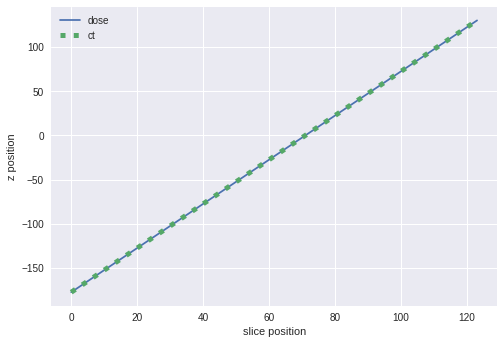

In [11]:
import matplotlib.pyplot as plt
plt.plot(dose_z_array, label='dose')
plt.plot(ct.z_array, ls=':', lw=5, label='ct')
plt.legend() # 凡例を表示
plt.xlabel('slice position')
plt.ylabel('z position')

In [0]:
from matplotlib import rc
rc('axes', grid=False)  # Gridを非表示

# 色の設定
from matplotlib.colors import ListedColormap
cm = plt.cm.jet
cm_list = cm(np.arange(cm.N))
cm_list[:,-1]  = 0.3
cm_list[:10,-1] = 0
myjet = ListedColormap(cm_list)

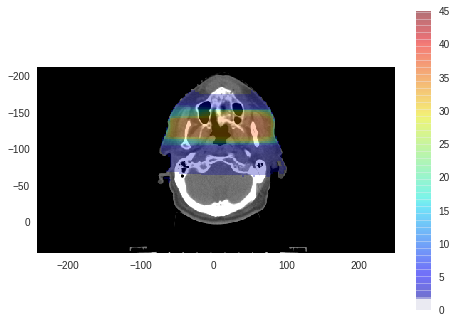

In [13]:
extent_ct = (ct.x_min, ct.x_max, ct.y_max, ct.y_min) # CTの表示範囲
extent_dose = (dose_x_min, dose_x_max, dose_y_max, dose_y_min) # Doseの表示範囲

slice_position = 30

plt.imshow(ct.volume[slice_position,:,:],
           cmap='gray', vmin=-300, vmax=500, extent=extent_ct)
plt.imshow(dose[slice_position,:,:],
           cmap=myjet, vmin=0, vmax=45, extent=extent_dose)
plt.colorbar()

In [14]:
# アニメーション表示
from matplotlib import animation
from IPython.display import HTML

fig, ax = plt.subplots()
plt.close()

def update(frame):
    if frame != 0:
        ax.cla()
    ax.imshow(ct.volume[frame,:,:],
               cmap='gray', vmin=-300, vmax=500, extent=extent_ct)
    ax.imshow(dose[frame,:,:],
               cmap=myjet, vmin=0, vmax=45, extent=extent_dose)
    
anim = animation.FuncAnimation(fig, update, interval=30)
HTML(anim.to_jshtml())

### Coronal, Sagittal断面

Text(0.5, 1.0, 'Sagittal')

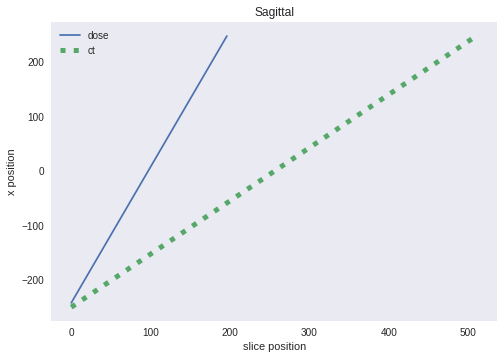

In [15]:
plt.plot(dose_x_array, label='dose')
plt.plot(ct.x_array, ls=':', lw=5, label='ct')
plt.legend() # 凡例を表示
plt.xlabel('slice position')
plt.ylabel('x position')
plt.title('Sagittal')

Text(0.5, 1.0, 'Coronal')

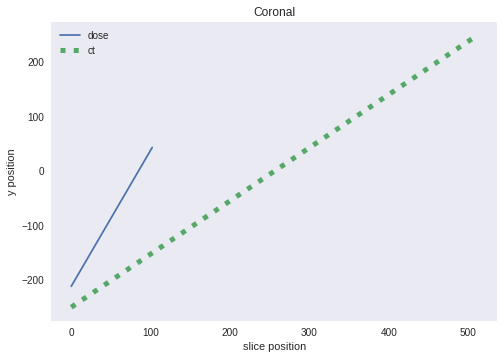

In [16]:
plt.plot(dose_y_array, label='dose')
plt.plot(ct.y_array, ls=':', lw=5, label='ct')
plt.legend() # 凡例を表示
plt.xlabel('slice position')
plt.ylabel('y position')
plt.title('Coronal')

In [17]:
print('Axial CT画像の左上の座標', ct.position[:2])
print('Axial線量分布の左上の座標', dose_file.ImagePositionPatient[:2])
print('')
print('Axial CT画像のピクセル間隔', ct.pixel_spacing)
print('Axial線量分布のピクセル間隔', dose_file.PixelSpacing)
print('')
print('Axial CT画像のピクセル数(列数, 行数)', ct.columns, ct.rows)
print('Axial線量分布のピクセル数(列数, 行数)', dose_file.Columns, dose_file.Rows)

Axial CT画像の左上の座標 ["-250", "-250"]
Axial線量分布の左上の座標 ["-242.056866", "-211.6242531"]

Axial CT画像のピクセル間隔 ['9.76562e-1', '9.76562e-1']
Axial線量分布のピクセル間隔 ['2.5', '2.5']

Axial CT画像のピクセル数(列数, 行数) 512 512
Axial線量分布のピクセル数(列数, 行数) 197 103


In [18]:
from scipy.interpolate import interp1d  # interp1dクラスをimport

f = interp1d(ct.y_array, ct.volume, axis=1)  # coronal方向の補間用関数
ct_y_new = f(dose_y_array) # 補間するための座標を与える

print('元の3次元データの形状', ct.volume.shape)
print('新しい3次元データの形状', ct_y_new.shape)

元の3次元データの形状 (124, 512, 512)
新しい3次元データの形状 (124, 103, 512)


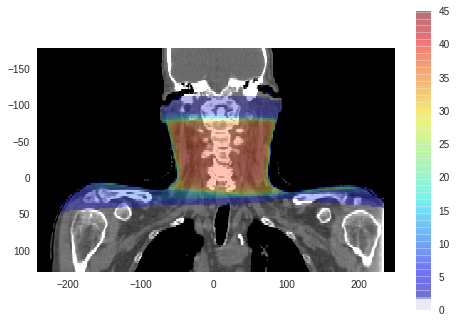

In [19]:
extent_ct_y = (ct.x_min, ct.x_max, ct.z_max, ct.z_min) # CTの表示範囲
extent_dose_y = (dose_x_min, dose_x_max, dose_z_max, dose_z_min) # Doseの表示範囲

slice_position = 50

plt.imshow(ct_y_new[:,slice_position,:],
           cmap='gray', vmin=-300, vmax=500, extent=extent_ct_y)
plt.imshow(dose[:,slice_position,:],
           cmap=myjet, vmin=0, vmax=45, extent=extent_dose_y)
plt.colorbar()

In [20]:
fig, ax = plt.subplots()
plt.close()

def update(frame):
    if frame != 0:
        ax.cla()
    ax.imshow(ct_y_new[:,frame,:],
               cmap='gray', vmin=-300, vmax=500, extent=extent_ct_y)
    ax.imshow(dose[:,frame,:],
               cmap=myjet, vmin=0, vmax=45, extent=extent_dose_y)
    
anim = animation.FuncAnimation(fig, update, interval=30, frames=dose.shape[1])
HTML(anim.to_jshtml())

In [21]:
f = interp1d(ct.x_array, ct.volume, axis=2)  # sagittal方向の補間用関数
ct_x_new = f(dose_x_array) # 補間するための座標を与える

print('元の3次元データの形状', ct.volume.shape)
print('新しい3次元データの形状', ct_x_new.shape)

元の3次元データの形状 (124, 512, 512)
新しい3次元データの形状 (124, 512, 197)


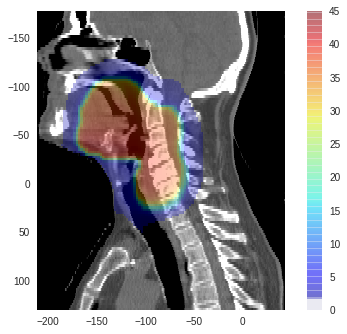

In [22]:
extent_ct_x = (ct.y_min, ct.y_max, ct.z_max, ct.z_min) # CTの表示範囲
extent_dose_x = (dose_y_min, dose_y_max, dose_z_max, dose_z_min) # Doseの表示範囲

slice_position = 100

plt.imshow(ct_x_new[:,:,slice_position],
           cmap='gray', vmin=-300, vmax=500, extent=extent_ct_x)
plt.imshow(dose[:,:,slice_position],
           cmap=myjet, vmin=0, vmax=45, extent=extent_dose_x)
plt.colorbar()

In [23]:
fig, ax = plt.subplots()
plt.close()

def update(frame):
    if frame != 0:
        ax.cla()
    ax.imshow(ct_x_new[:,:,frame],
               cmap='gray', vmin=-300, vmax=500, extent=extent_ct_x)
    ax.imshow(dose[:,:,frame],
               cmap=myjet, vmin=0, vmax=45, extent=extent_dose_x)
    
anim = animation.FuncAnimation(fig, update, interval=30, frames=dose.shape[2])
HTML(anim.to_jshtml())